# NJUNN final

# Prepare Data


In [1]:
from torch.utils.data import Dataset, DataLoader
import cv2
import os

class FaceDataset(Dataset):
    def __init__(self, fnames, transform):
        self.transform = transform
        self.fnames = fnames
        self.num_samples = len(self.fnames)
    def __getitem__(self,idx):
        fname = self.fnames[idx]
        img = cv2.imread(fname)
        img = self.BGR2RGB(img) #because "torchvision.utils.save_image" use RGB
        img = self.transform(img)
        return img

    def __len__(self):
        return self.num_samples

    def BGR2RGB(self,img):
        return cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

import glob
import torchvision.transforms as transforms

def get_dataset(root):
    fnames = glob.glob(os.path.join(root, '*'))
    # resize the image to (64, 64)
    # linearly map [0, 1] to [-1, 1]
    transform = transforms.Compose(
        [transforms.ToPILImage(),
         transforms.Resize((64, 64)),
         transforms.ToTensor(),
         transforms.Normalize(mean=[0.5] * 3, std=[0.5] * 3) ] )
    dataset = FaceDataset(fnames, transform)
    return dataset

In [2]:
import random
import torch
import numpy as np

def same_seeds(seed):
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)  # if you are using multi-GPU.
    np.random.seed(seed)  # Numpy module.
    random.seed(seed)  # Python random module.
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True


## Model

In [3]:
import torch.nn as nn
import torch.nn.functional as F

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    #input (N, in_dim)
    #output (N, 3, 64, 64)
    def __init__(self, in_dim, dim=32):
        super(Generator, self).__init__()
        self.fc = nn.Linear(in_dim, dim*8*5*5)
        self.fc_bn = nn.BatchNorm2d(256)
        self.deconv1 = nn.ConvTranspose2d(256, 256, 3, 2, 1)
        self.deconv1_bn = nn.BatchNorm2d(256)
        self.deconv2 = nn.ConvTranspose2d(256, 256, 3, 1, 1)
        self.deconv2_bn = nn.BatchNorm2d(256)
        self.deconv3 = nn.ConvTranspose2d(256, 256, 3, 2, 1)
        self.deconv3_bn = nn.BatchNorm2d(256)
        self.deconv4 = nn.ConvTranspose2d(256, 256, 3, 1, 1)
        self.deconv4_bn = nn.BatchNorm2d(256)
        self.deconv5 = nn.ConvTranspose2d(256, 128, 3, 2, 1)
        self.deconv5_bn = nn.BatchNorm2d(128)
        self.deconv6 = nn.ConvTranspose2d(128,  64, 3, 2, 2, 1)
        self.deconv6_bn = nn.BatchNorm2d(64)
        self.deconv7 = nn.ConvTranspose2d(64 ,   3, 3, 1, 1)
        self.relu = nn.ReLU()
        self.tanh = nn.Tanh()

    def forward(self, input):
        x = self.fc(input).reshape((-1, 256, 5, 5))
        x = self.relu(self.fc_bn(x))
        x = self.relu(self.deconv1_bn(self.deconv1(x)))
        x = self.relu(self.deconv2_bn(self.deconv2(x)))
        x = self.relu(self.deconv3_bn(self.deconv3(x)))
        x = self.relu(self.deconv4_bn(self.deconv4(x)))
        x = self.relu(self.deconv5_bn(self.deconv5(x)))
        x = self.relu(self.deconv6_bn(self.deconv6(x)))
        x = self.tanh(self.deconv7(x))
        return x


    
class Discriminator(nn.Module):
    """
    input (N, 3, 64, 64)
    output (N, )
    """
    def __init__(self, in_dim, dim=64):
        super(Discriminator, self).__init__()
        def conv_bn_lrelu(in_dim, out_dim):
            return nn.Sequential(
                nn.Conv2d(in_dim, out_dim, 5, 2, 2),
                nn.BatchNorm2d(out_dim),
                nn.LeakyReLU(0.2),
                nn.Dropout2d(0.25))
        self.ls = nn.Sequential(
            nn.Conv2d(in_dim, dim, 5, 2, 2), nn.LeakyReLU(0.2),
            conv_bn_lrelu(dim, dim * 2),
            conv_bn_lrelu(dim * 2, dim * 4),
            conv_bn_lrelu(dim * 4, dim * 8))
        self.fc = nn.Linear(128*dim,1)
        self.apply(weights_init)        
    def forward(self, x):
        y = self.ls(x)
        y = y.view(y.shape[0], -1)
        y = self.fc(y)
        y = y.view(-1)
        return y

# Training

In [4]:
import torch
from torch import optim
from torch.autograd import Variable
import torchvision

# hyperparameters 
batch_size = 64
z_dim = 1024
lr = 1e-4
n_epoch = 10
workspace_dir = "../input/njunnfinal3"
cur_dir = "./"
save_dir = os.path.join(cur_dir, 'logs')
os.makedirs(save_dir, exist_ok=True)

# model
G = Generator(in_dim=z_dim).cuda()
D = Discriminator(3).cuda()
G.train()
D.train()

# loss criterion
criterion = nn.MSELoss()

# optimizer
opt_D = torch.optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
opt_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))


same_seeds(0)
# dataloader (You might need to edit the dataset path if you use extra dataset.)
dataset = get_dataset(os.path.join(workspace_dir, 'faces'))
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=4)


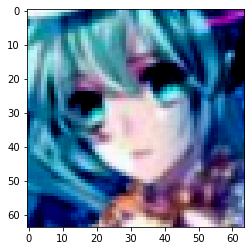

In [5]:
import matplotlib.pyplot as plt
plt.imshow(dataset[10].numpy().transpose(1,2,0))

Epoch [1/51] 801/801 Loss_D: 0.1022 Loss_G: 0.8111 | Save some samples to ./logs/Epoch_001.jpg.


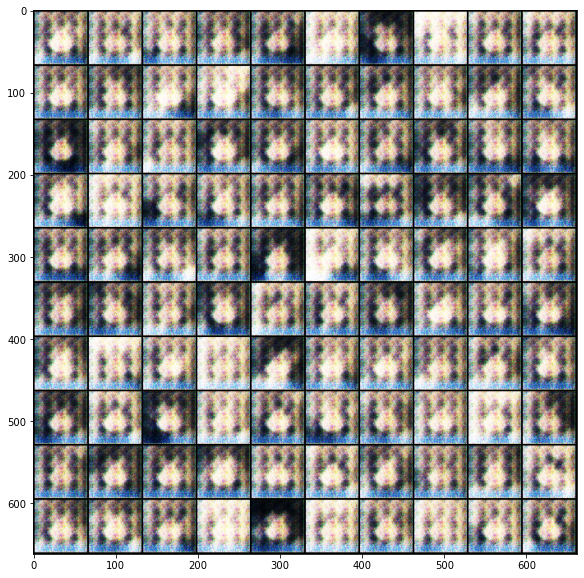

Epoch [2/51] 801/801 Loss_D: 0.0821 Loss_G: 1.2965 | Save some samples to ./logs/Epoch_002.jpg.


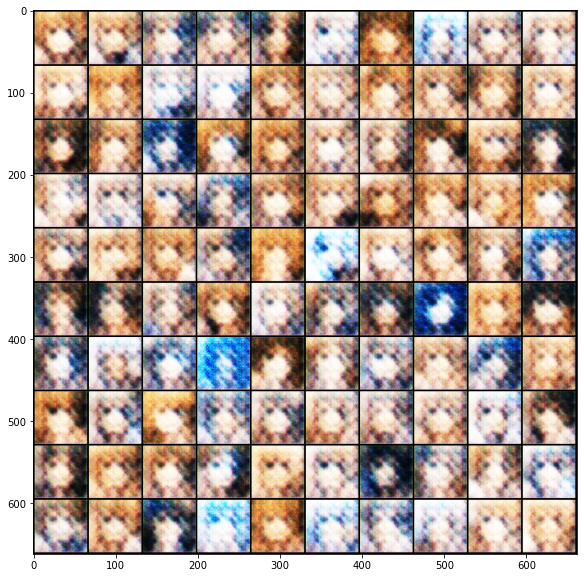

Epoch [3/51] 801/801 Loss_D: 0.0553 Loss_G: 0.5191 | Save some samples to ./logs/Epoch_003.jpg.


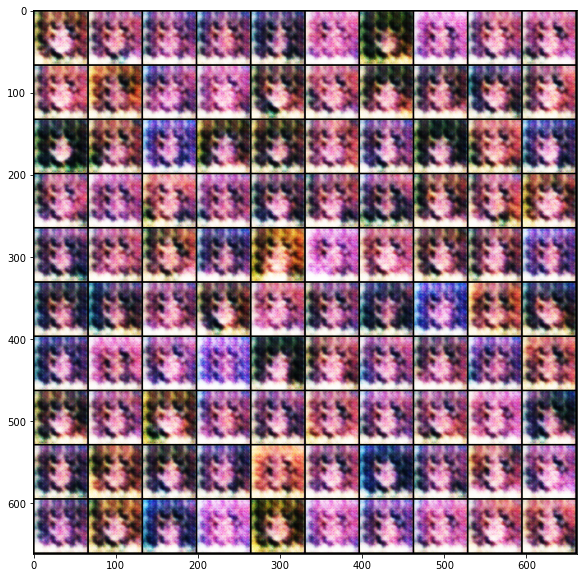

Epoch [4/51] 801/801 Loss_D: 0.1031 Loss_G: 0.8649 | Save some samples to ./logs/Epoch_004.jpg.


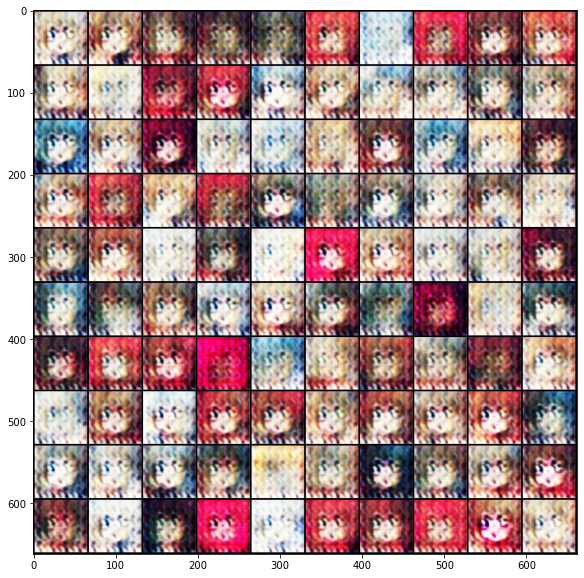

Epoch [5/51] 801/801 Loss_D: 0.0464 Loss_G: 0.9375 | Save some samples to ./logs/Epoch_005.jpg.


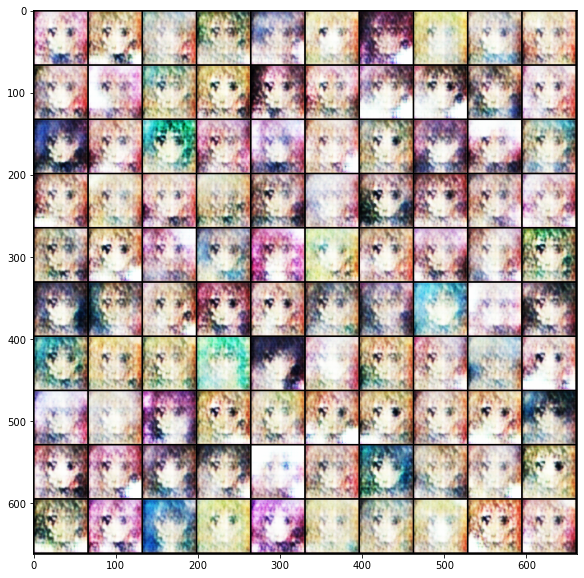

Epoch [6/51] 801/801 Loss_D: 0.0877 Loss_G: 0.4168 | Save some samples to ./logs/Epoch_006.jpg.


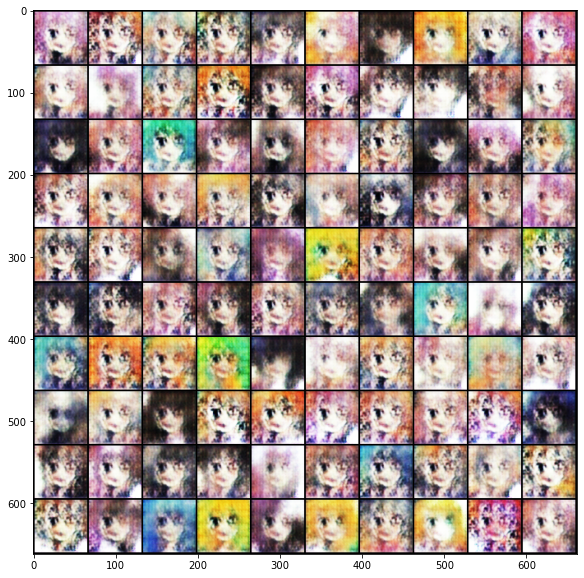

Epoch [7/51] 801/801 Loss_D: 0.0829 Loss_G: 0.8510 | Save some samples to ./logs/Epoch_007.jpg.


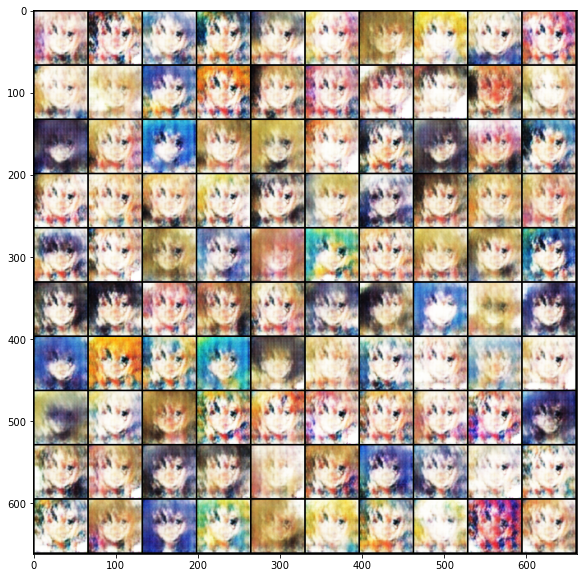

Epoch [8/51] 801/801 Loss_D: 0.1508 Loss_G: 0.9846 | Save some samples to ./logs/Epoch_008.jpg.


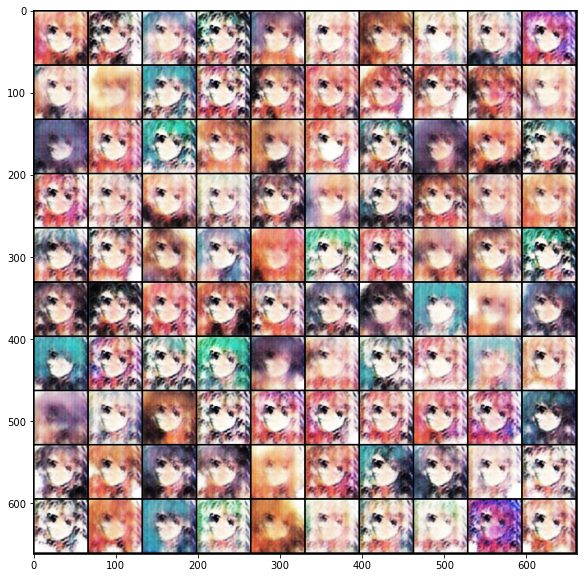

Epoch [9/51] 801/801 Loss_D: 0.1655 Loss_G: 0.6356 | Save some samples to ./logs/Epoch_009.jpg.


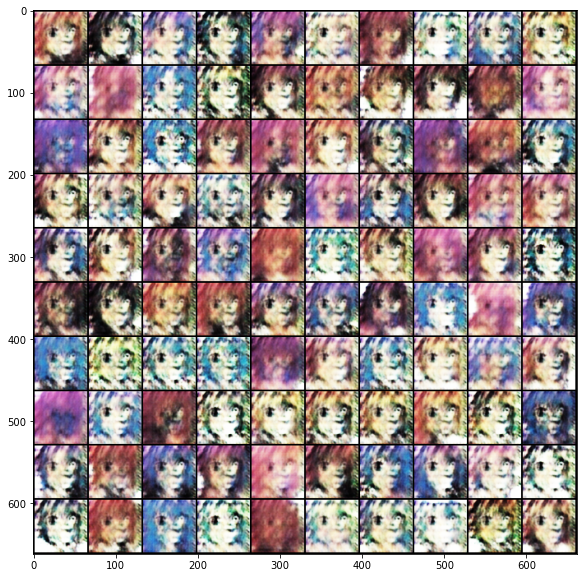

Epoch [10/51] 801/801 Loss_D: 0.0658 Loss_G: 0.6711 | Save some samples to ./logs/Epoch_010.jpg.


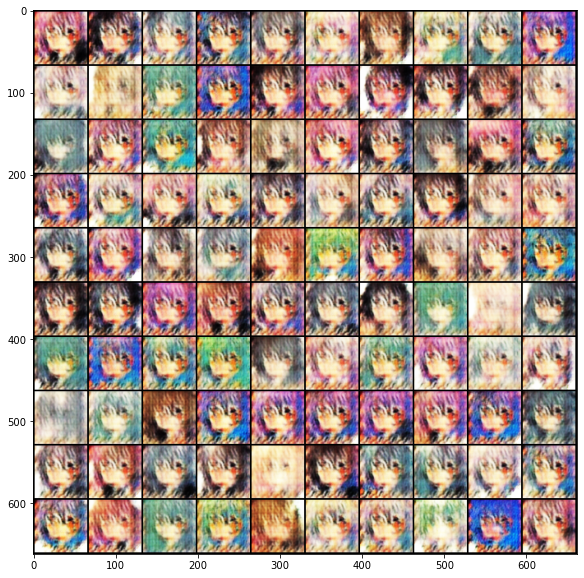

Epoch [11/51] 801/801 Loss_D: 0.0874 Loss_G: 0.8521 | Save some samples to ./logs/Epoch_011.jpg.


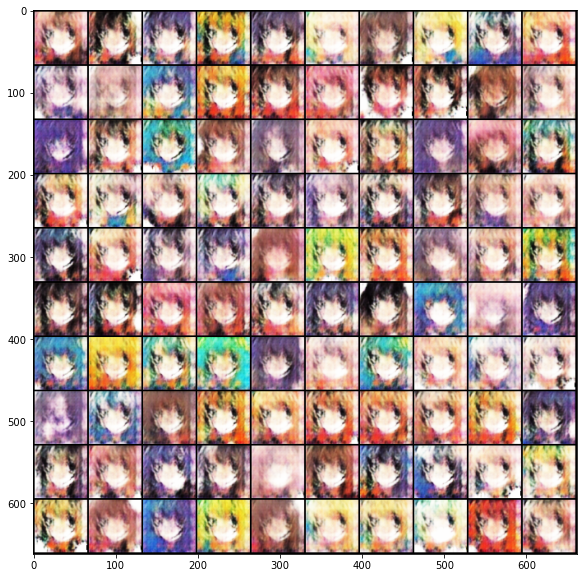

Epoch [12/51] 801/801 Loss_D: 0.2393 Loss_G: 1.1272 | Save some samples to ./logs/Epoch_012.jpg.


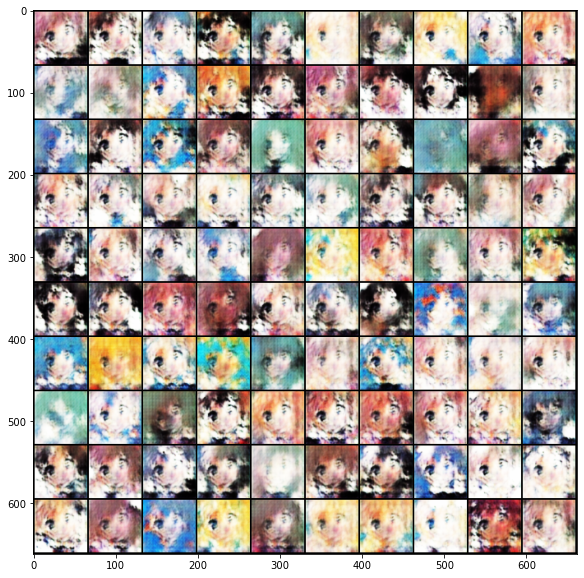

Epoch [13/51] 801/801 Loss_D: 0.0685 Loss_G: 1.0732 | Save some samples to ./logs/Epoch_013.jpg.


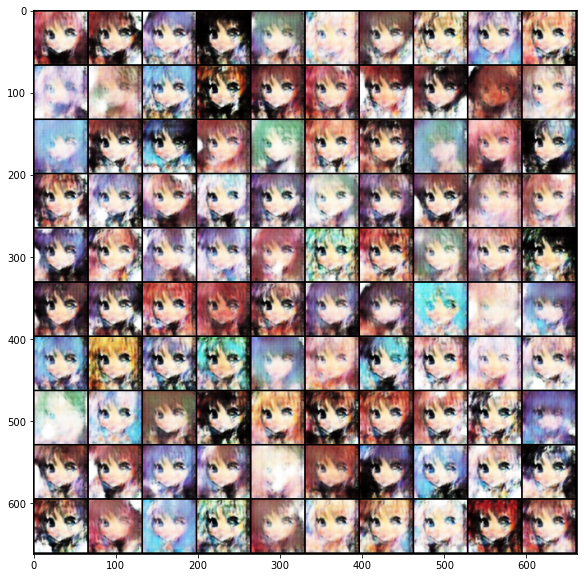

Epoch [14/51] 801/801 Loss_D: 0.2455 Loss_G: 1.6854 | Save some samples to ./logs/Epoch_014.jpg.


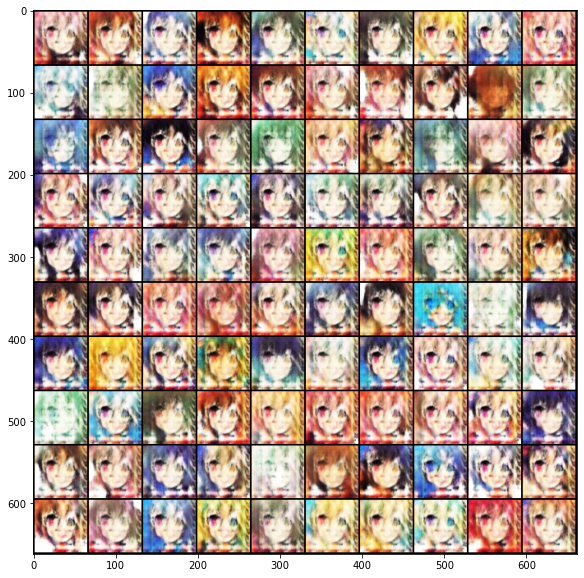

Epoch [15/51] 801/801 Loss_D: 0.0711 Loss_G: 0.7567 | Save some samples to ./logs/Epoch_015.jpg.


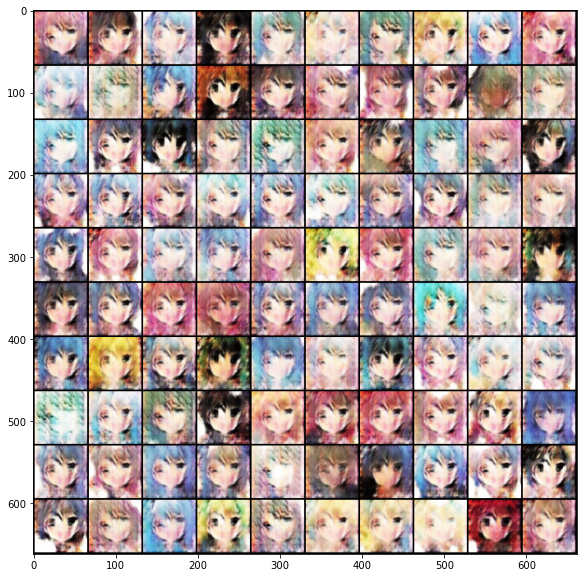

Epoch [16/51] 801/801 Loss_D: 0.0292 Loss_G: 0.8000 | Save some samples to ./logs/Epoch_016.jpg.


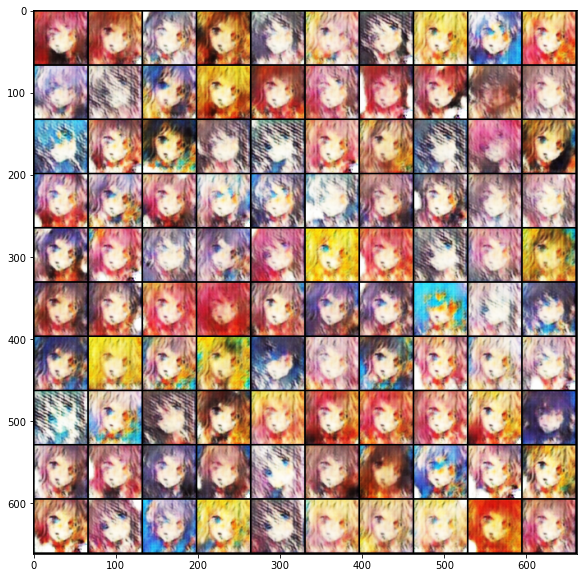

Epoch [17/51] 801/801 Loss_D: 0.1106 Loss_G: 1.6838 | Save some samples to ./logs/Epoch_017.jpg.


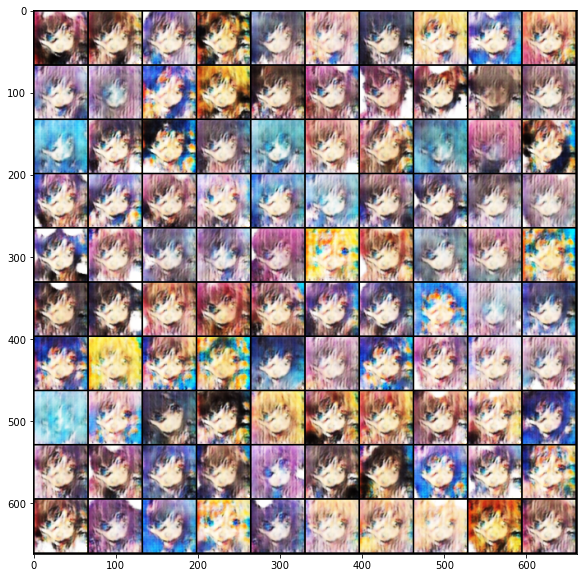

Epoch [18/51] 801/801 Loss_D: 0.1147 Loss_G: 0.8867 | Save some samples to ./logs/Epoch_018.jpg.


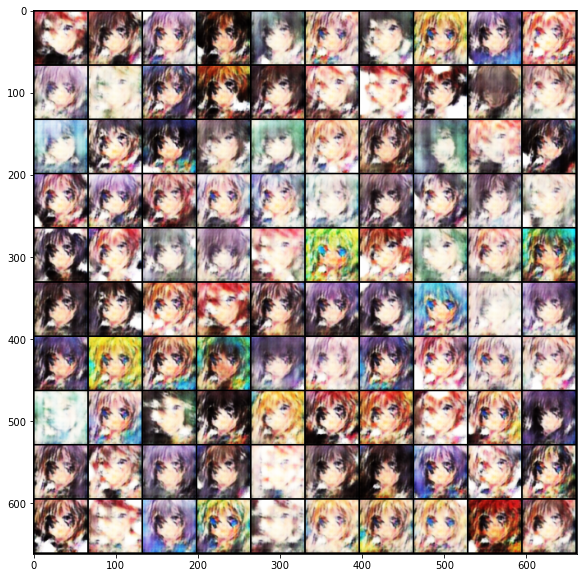

Epoch [19/51] 801/801 Loss_D: 0.0792 Loss_G: 1.0238 | Save some samples to ./logs/Epoch_019.jpg.


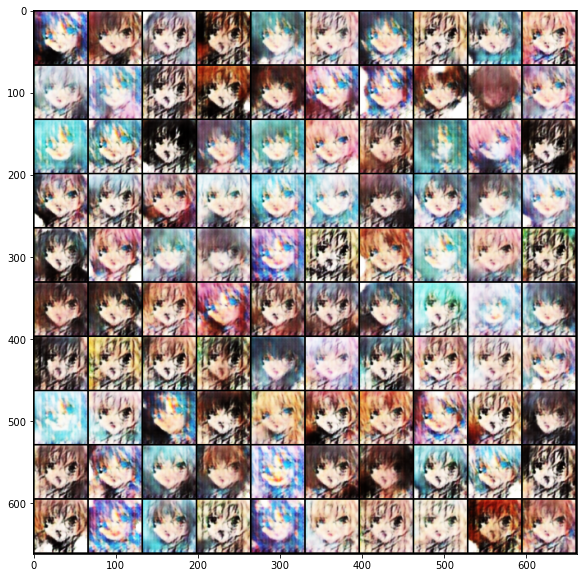

Epoch [20/51] 801/801 Loss_D: 0.1959 Loss_G: 2.7516 | Save some samples to ./logs/Epoch_020.jpg.


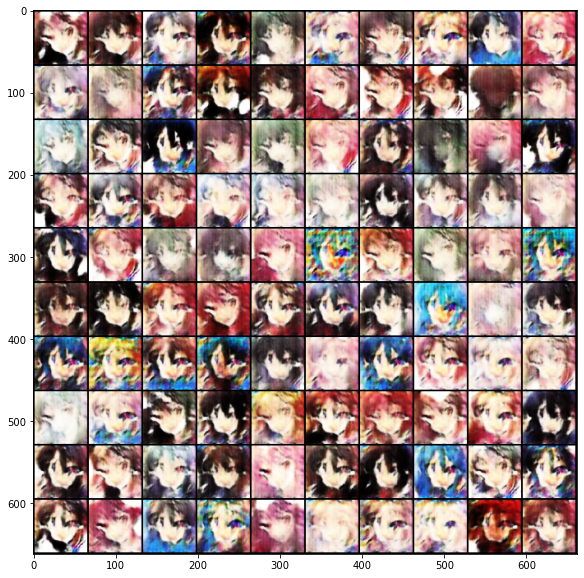

Epoch [21/51] 801/801 Loss_D: 0.1490 Loss_G: 1.6960 | Save some samples to ./logs/Epoch_021.jpg.


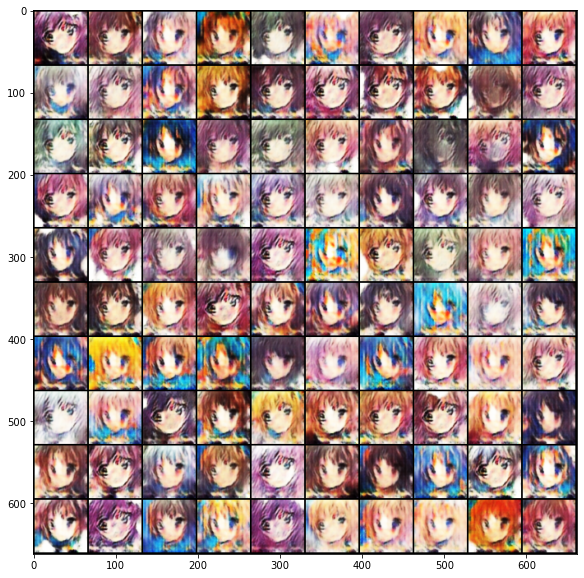

Epoch [22/51] 801/801 Loss_D: 0.1758 Loss_G: 0.3296 | Save some samples to ./logs/Epoch_022.jpg.


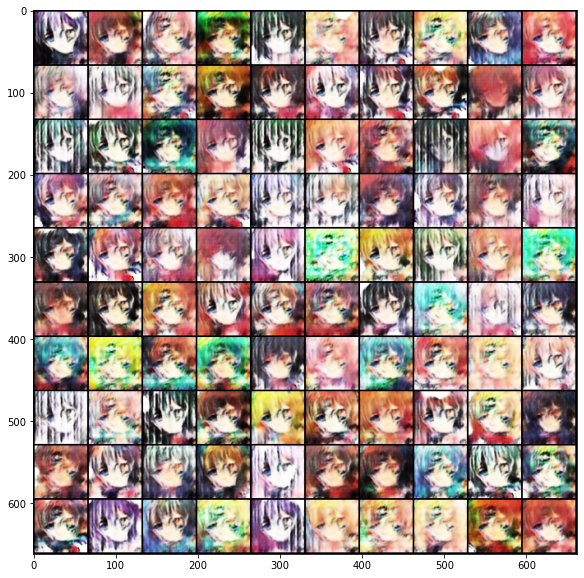

Epoch [23/51] 801/801 Loss_D: 0.0871 Loss_G: 3.1735 | Save some samples to ./logs/Epoch_023.jpg.


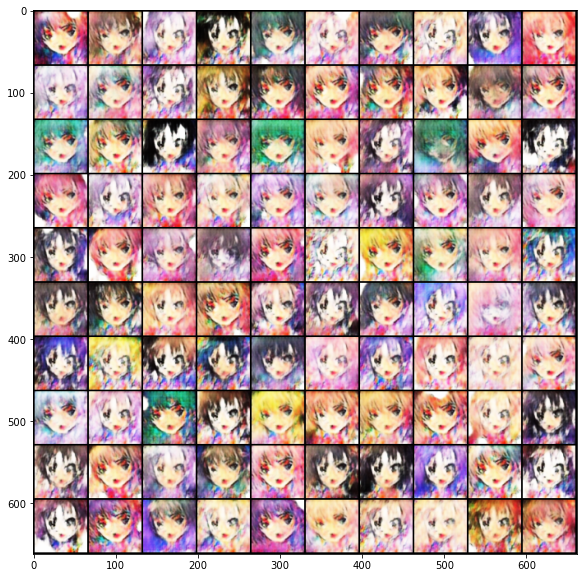

Epoch [24/51] 801/801 Loss_D: 0.0653 Loss_G: 2.0369 | Save some samples to ./logs/Epoch_024.jpg.


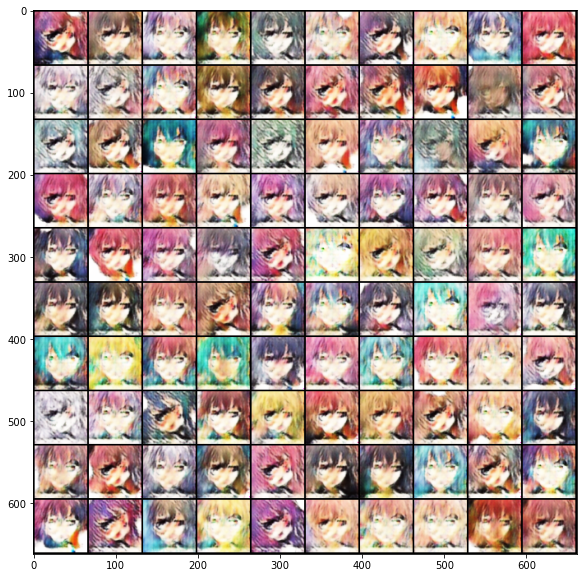

Epoch [25/51] 801/801 Loss_D: 0.1666 Loss_G: 2.0315 | Save some samples to ./logs/Epoch_025.jpg.


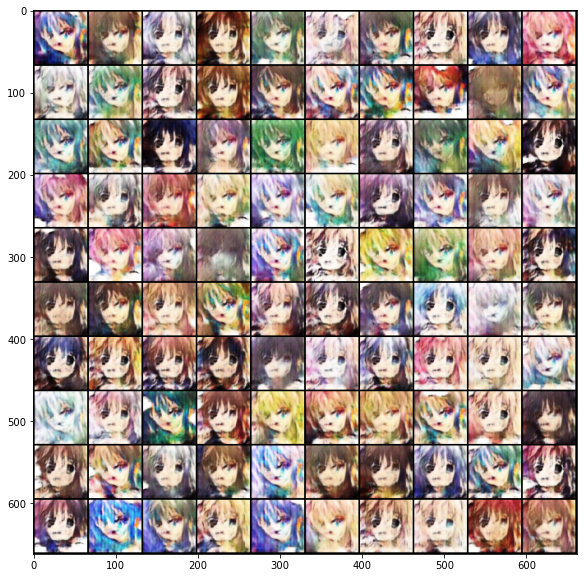

Epoch [26/51] 801/801 Loss_D: 0.0986 Loss_G: 0.8726 | Save some samples to ./logs/Epoch_026.jpg.


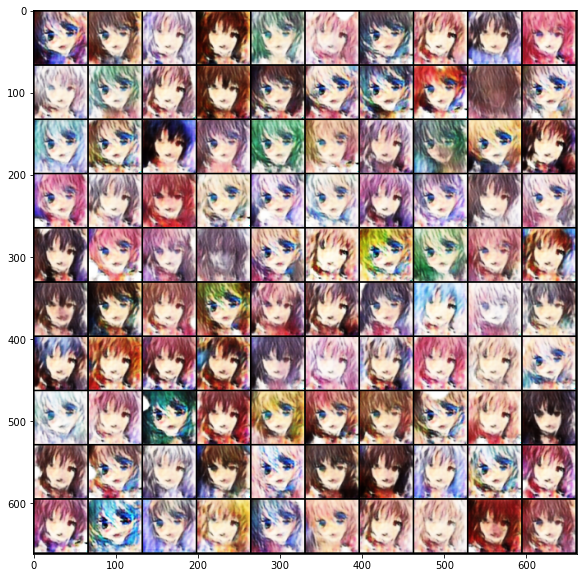

Epoch [27/51] 801/801 Loss_D: 0.0504 Loss_G: 1.4042 | Save some samples to ./logs/Epoch_027.jpg.


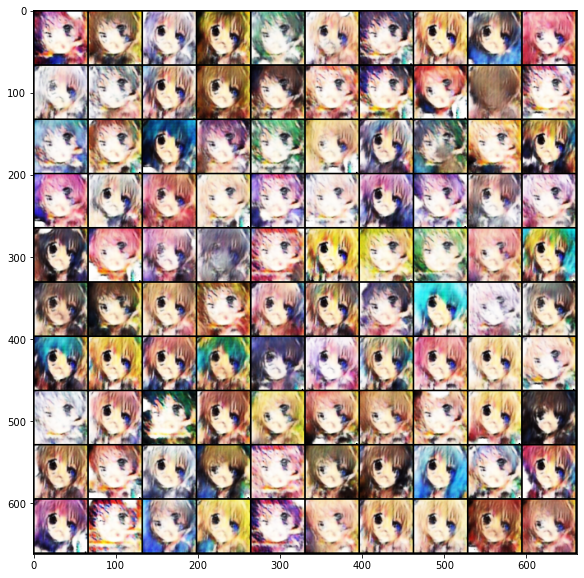

Epoch [28/51] 801/801 Loss_D: 0.1920 Loss_G: 1.0230 | Save some samples to ./logs/Epoch_028.jpg.


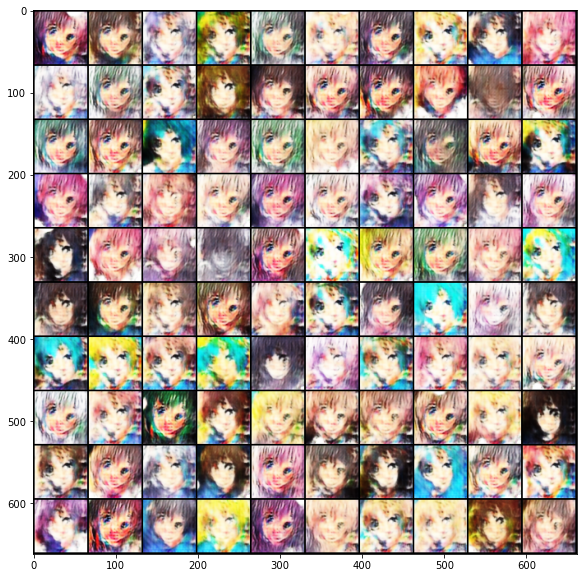

Epoch [29/51] 801/801 Loss_D: 0.1446 Loss_G: 0.6208 | Save some samples to ./logs/Epoch_029.jpg.


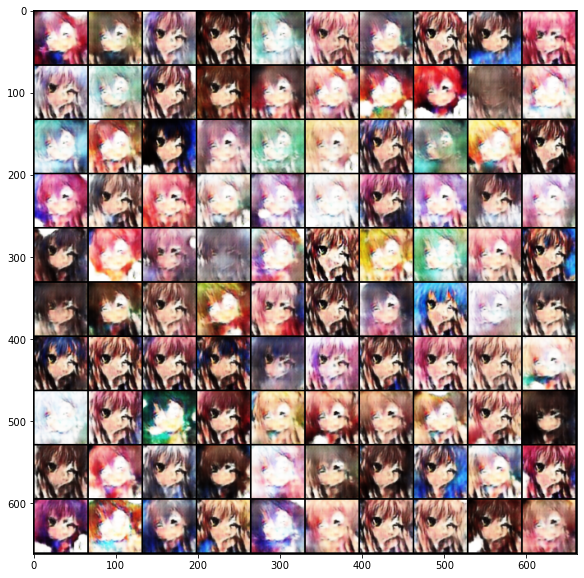

Epoch [30/51] 801/801 Loss_D: 0.0818 Loss_G: 0.5266 | Save some samples to ./logs/Epoch_030.jpg.


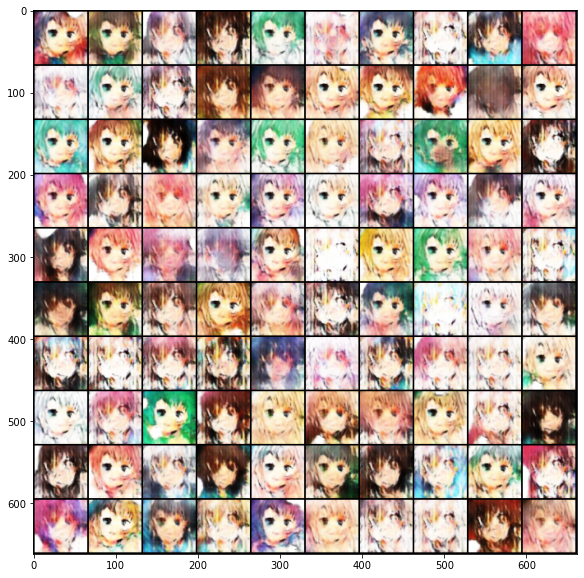

Epoch [31/51] 801/801 Loss_D: 0.2836 Loss_G: 2.5562 | Save some samples to ./logs/Epoch_031.jpg.


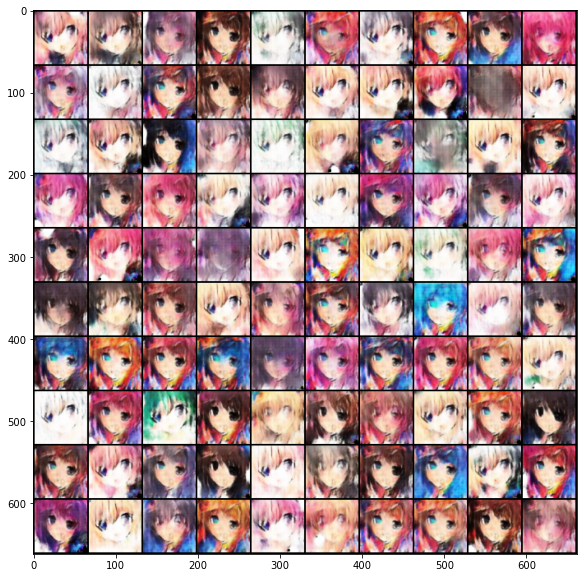

Epoch [32/51] 801/801 Loss_D: 0.0612 Loss_G: 0.9033 | Save some samples to ./logs/Epoch_032.jpg.


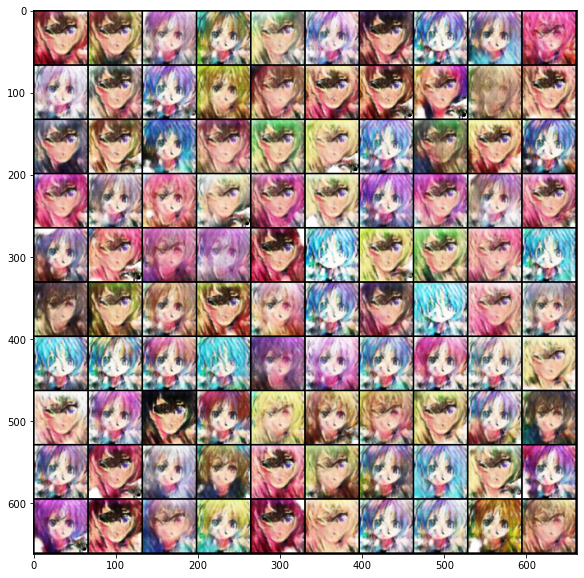

Epoch [33/51] 801/801 Loss_D: 0.2207 Loss_G: 0.4989 | Save some samples to ./logs/Epoch_033.jpg.


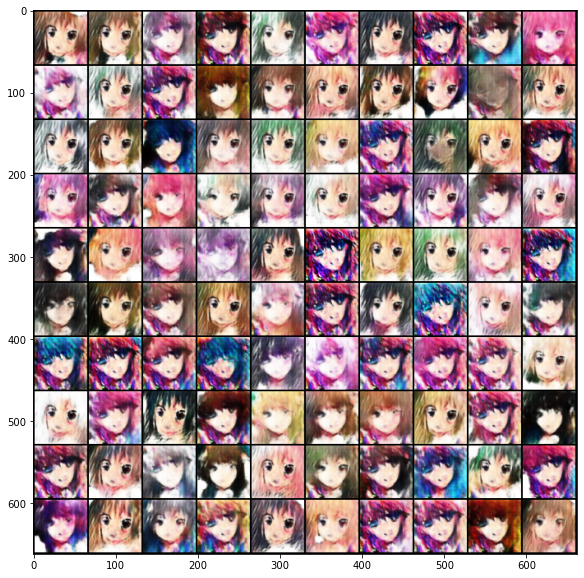

Epoch [34/51] 801/801 Loss_D: 0.1637 Loss_G: 0.0607 | Save some samples to ./logs/Epoch_034.jpg.


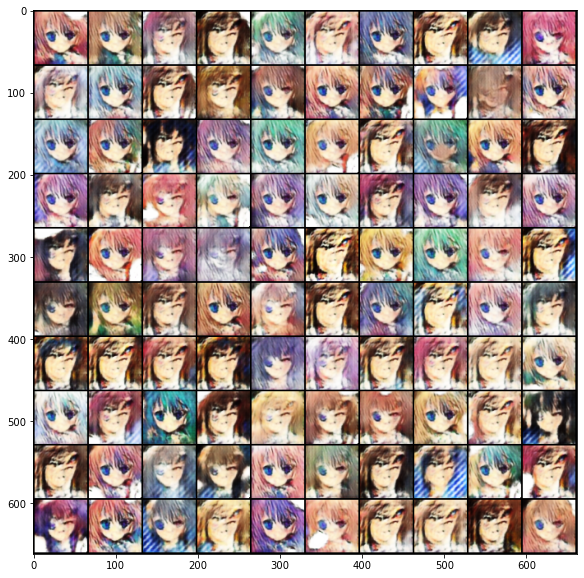

Epoch [35/51] 801/801 Loss_D: 0.1098 Loss_G: 1.1884 | Save some samples to ./logs/Epoch_035.jpg.


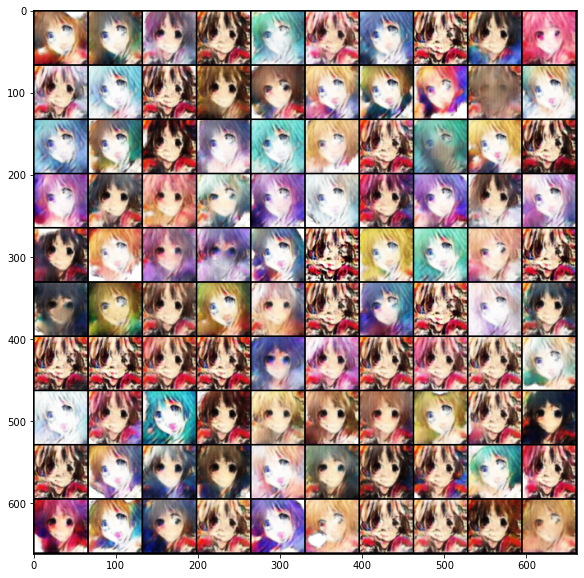

Epoch [36/51] 801/801 Loss_D: 0.2163 Loss_G: 0.3988 | Save some samples to ./logs/Epoch_036.jpg.


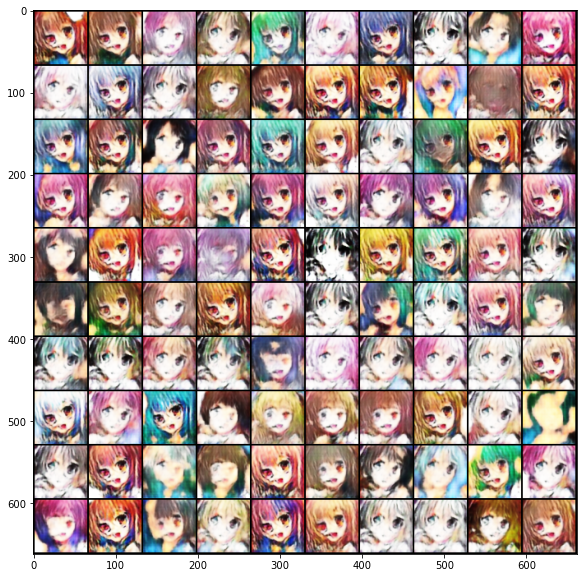

Epoch [37/51] 801/801 Loss_D: 0.1718 Loss_G: 0.7368 | Save some samples to ./logs/Epoch_037.jpg.


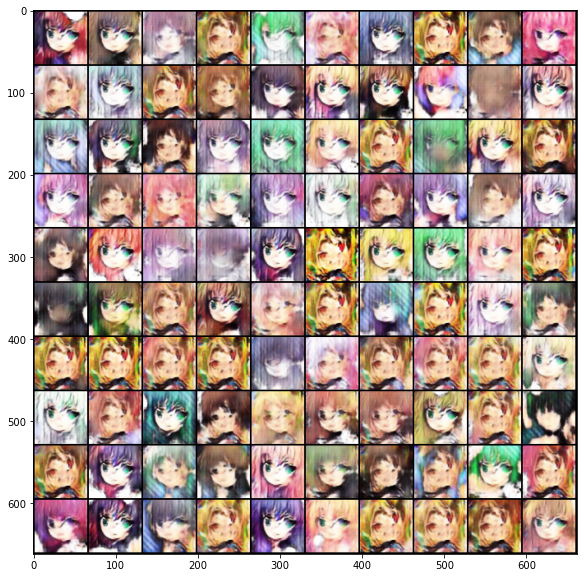

Epoch [38/51] 801/801 Loss_D: 0.0721 Loss_G: 0.9579 | Save some samples to ./logs/Epoch_038.jpg.


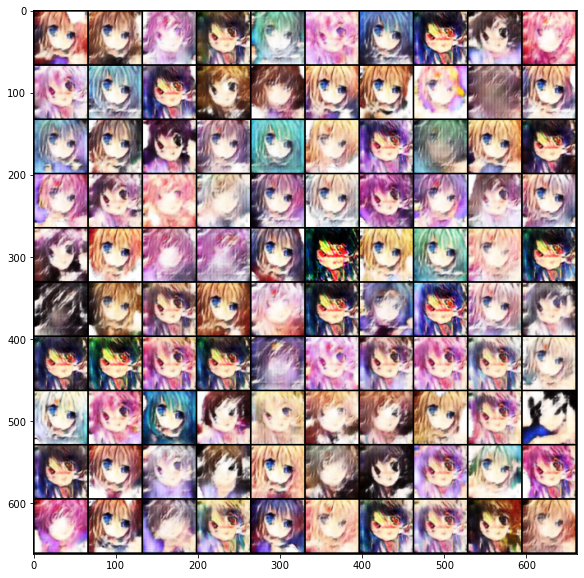

Epoch [39/51] 801/801 Loss_D: 0.0293 Loss_G: 1.7244 | Save some samples to ./logs/Epoch_039.jpg.


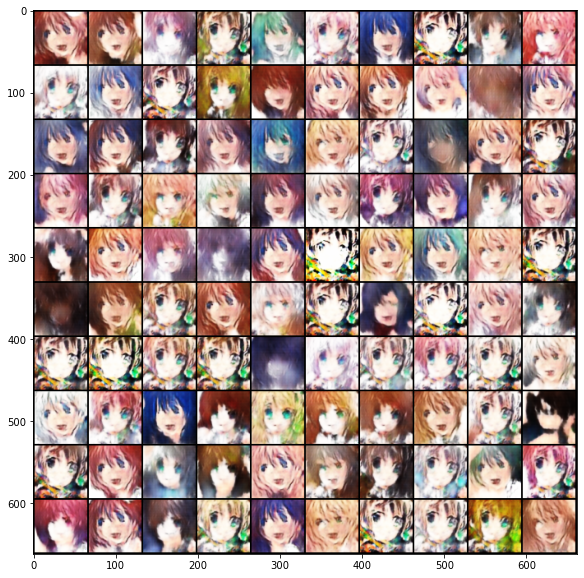

Epoch [40/51] 801/801 Loss_D: 0.0358 Loss_G: 1.7336 | Save some samples to ./logs/Epoch_040.jpg.


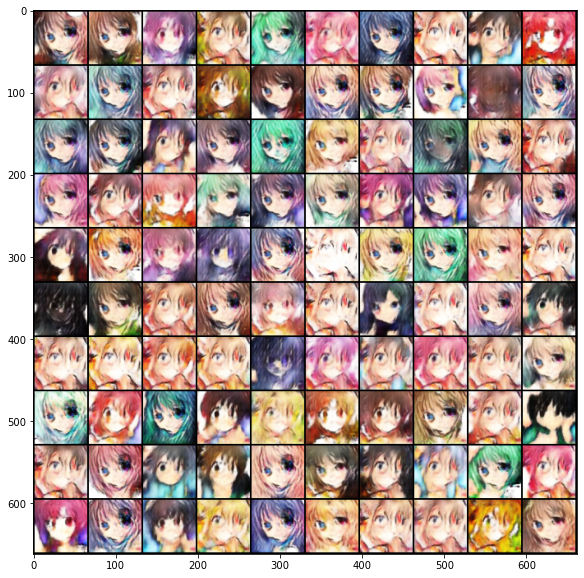

Epoch [41/51] 801/801 Loss_D: 0.0588 Loss_G: 1.2539 | Save some samples to ./logs/Epoch_041.jpg.


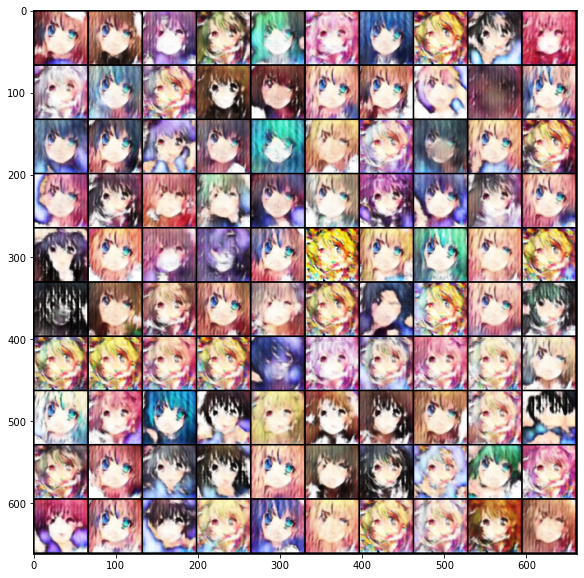

Epoch [42/51] 801/801 Loss_D: 0.0535 Loss_G: 0.9474 | Save some samples to ./logs/Epoch_042.jpg.


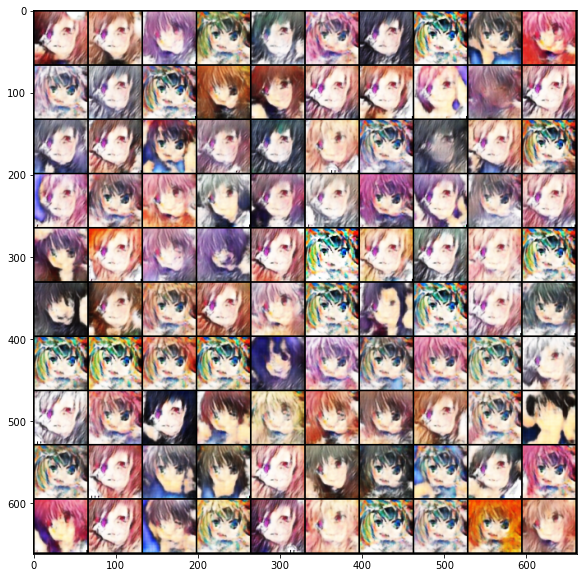

Epoch [43/51] 801/801 Loss_D: 0.0357 Loss_G: 1.0144 | Save some samples to ./logs/Epoch_043.jpg.


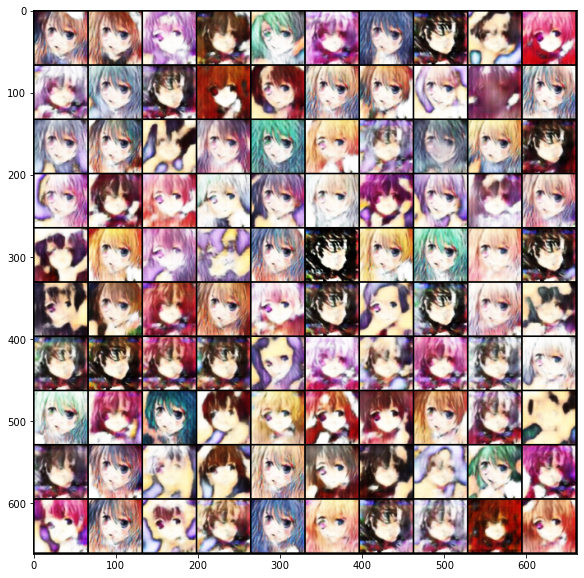

Epoch [44/51] 801/801 Loss_D: 0.1631 Loss_G: 0.1679 | Save some samples to ./logs/Epoch_044.jpg.


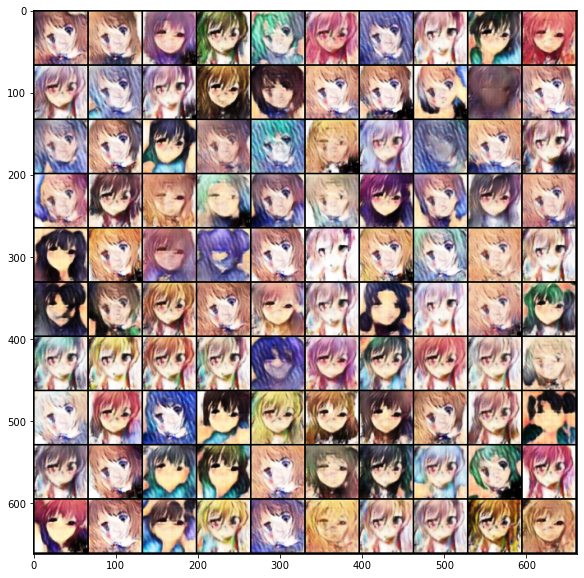

Epoch [45/51] 801/801 Loss_D: 0.0231 Loss_G: 0.6275 | Save some samples to ./logs/Epoch_045.jpg.


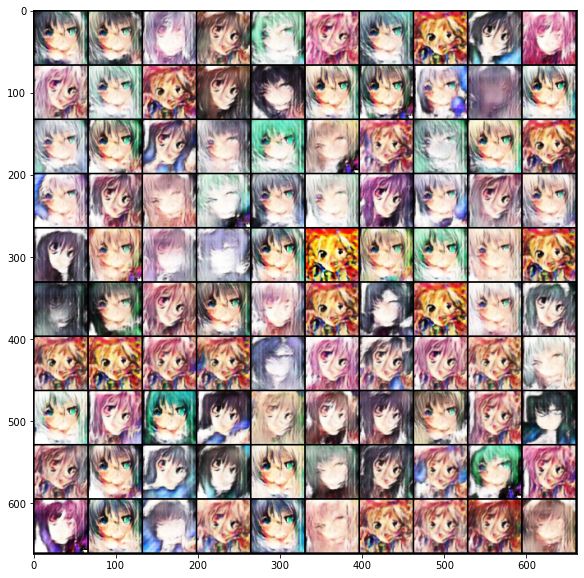

Epoch [46/51] 801/801 Loss_D: 0.1225 Loss_G: 0.3456 | Save some samples to ./logs/Epoch_046.jpg.


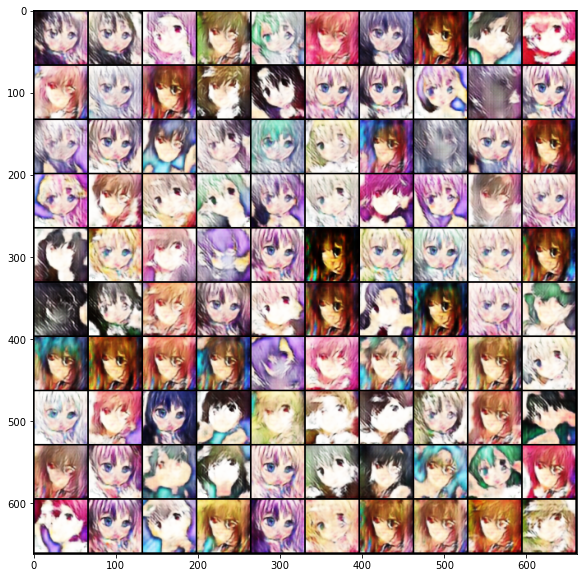

Epoch [47/51] 801/801 Loss_D: 0.0982 Loss_G: 0.8306 | Save some samples to ./logs/Epoch_047.jpg.


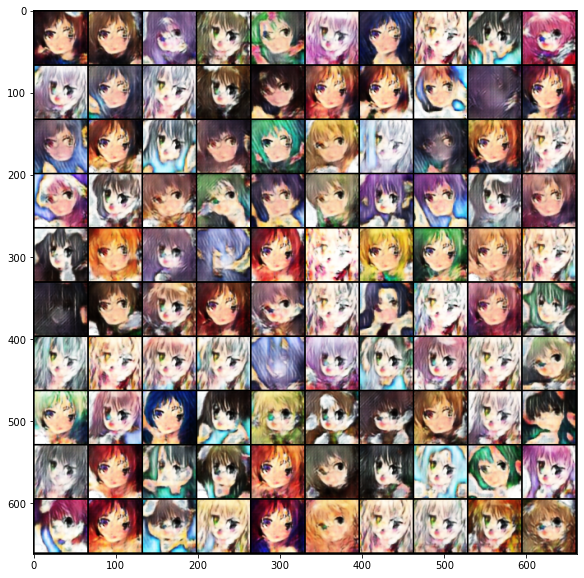

Epoch [48/51] 801/801 Loss_D: 0.0803 Loss_G: 1.8157 | Save some samples to ./logs/Epoch_048.jpg.


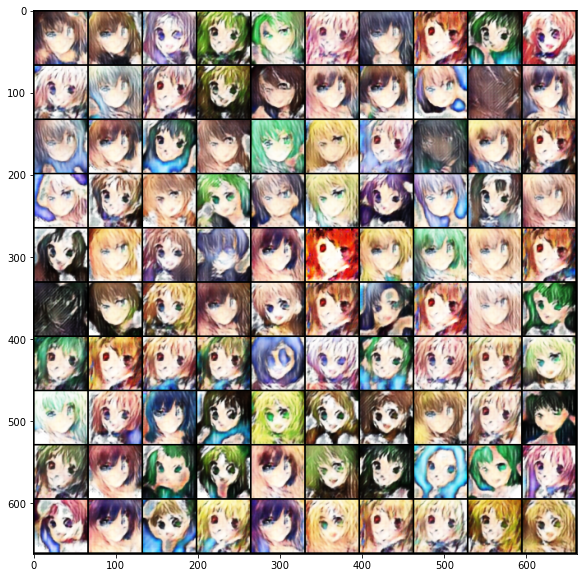

Epoch [49/51] 801/801 Loss_D: 0.0526 Loss_G: 0.5967 | Save some samples to ./logs/Epoch_049.jpg.


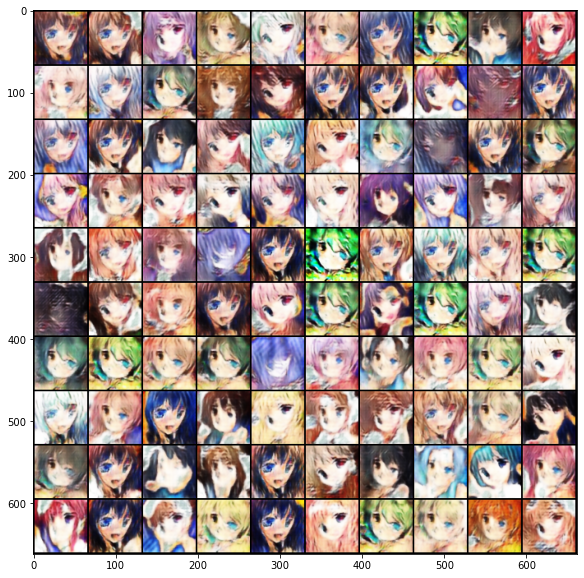

Epoch [50/51] 801/801 Loss_D: 0.0926 Loss_G: 1.4989 | Save some samples to ./logs/Epoch_050.jpg.


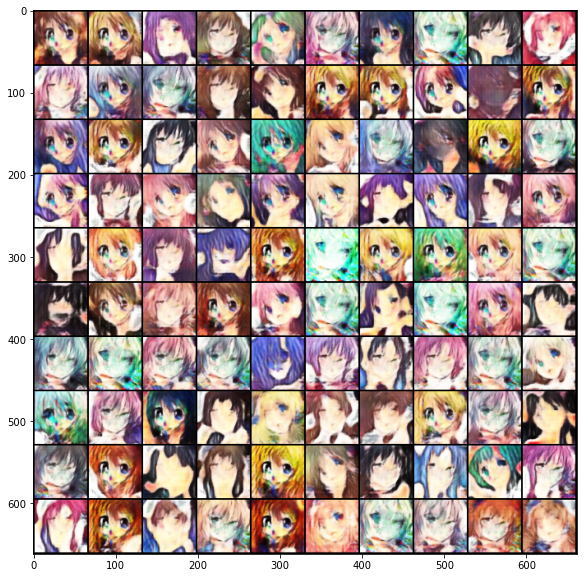

Epoch [51/51] 801/801 Loss_D: 0.4966 Loss_G: 0.0298 | Save some samples to ./logs/Epoch_051.jpg.


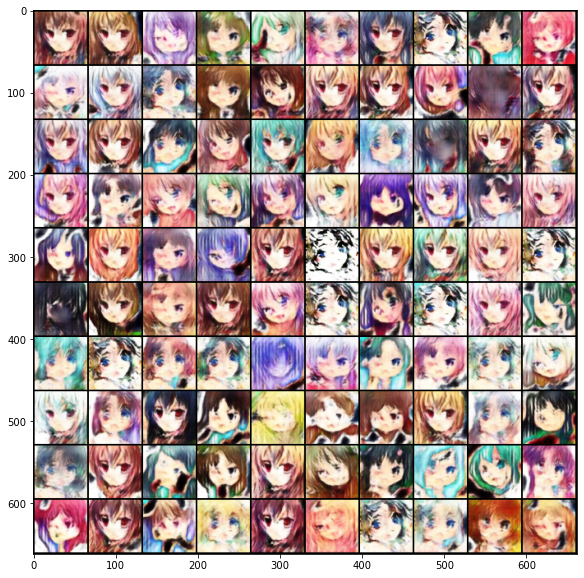

In [6]:
# for logging
z_sample = Variable(torch.randn(100, z_dim)).cuda()
n_epoch = 51
for e, epoch in enumerate(range(n_epoch)):
    for i, data in enumerate(dataloader):
        imgs = data
        imgs = imgs.cuda()

        bs = imgs.size(0)

        """ Train D """
        z = Variable(torch.randn(bs, z_dim)).cuda()
        r_imgs = Variable(imgs).cuda()
        f_imgs = G(z)

        # label        
        r_label = torch.ones((bs)).cuda()
        f_label = torch.zeros((bs)).cuda()

        # dis
        r_logit = D(r_imgs.detach())
        f_logit = D(f_imgs.detach())
        
        # compute loss
        r_loss = criterion(r_logit, r_label)
        f_loss = criterion(f_logit, f_label)
        loss_D = (r_loss + f_loss) / 2

        # update model
        D.zero_grad()
        loss_D.backward()
        opt_D.step()

        """ train G """
        # leaf
        z = Variable(torch.randn(bs, z_dim)).cuda()
        f_imgs = G(z)

        # dis
        f_logit = D(f_imgs)
        
        # compute loss
        loss_G = criterion(f_logit, r_label)

        # update model
        G.zero_grad()
        loss_G.backward()
        opt_G.step()

        # log
        print(f'\rEpoch [{epoch+1}/{n_epoch}] {i+1}/{len(dataloader)} Loss_D: {loss_D.item():.4f} Loss_G: {loss_G.item():.4f}', end='')
    G.eval()
    f_imgs_sample = (G(z_sample).data + 1) / 2.0
    filename = os.path.join(save_dir, f'Epoch_{epoch+1:03d}.jpg')
    torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
    print(f' | Save some samples to {filename}.')
    # show generated image
    grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
    plt.figure(figsize=(10,10))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()
    G.train()
    #if (e+1) % 5 == 0:
    if (e) % 5 == 0:
        torch.save(G.state_dict(), os.path.join(cur_dir, f'dcgan_g_{e:03d}.pth'))
        torch.save(D.state_dict(), os.path.join(cur_dir, f'dcgan_d_{e:03d}.pth'))



# Inference

In [7]:
import torch
# load pretrained model
G = Generator(z_dim)
G.load_state_dict(torch.load(os.path.join(cur_dir, 'dcgan_g_000.pth')))
G.eval()
G.cuda()

Generator(
  (fc): Linear(in_features=1024, out_features=6400, bias=True)
  (fc_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (deconv1): ConvTranspose2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (deconv1_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (deconv2): ConvTranspose2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (deconv2_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (deconv3): ConvTranspose2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (deconv3_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (deconv4): ConvTranspose2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (deconv4_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (deconv5): ConvTranspose2d(256, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 

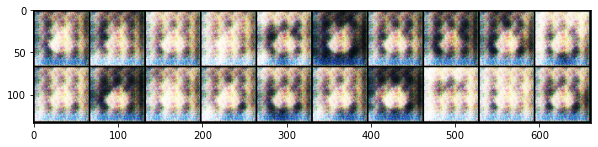

In [8]:
# generate images and save the result
n_output = 20
z_sample = Variable(torch.randn(n_output, z_dim)).cuda()
imgs_sample = (G(z_sample).data + 1) / 2.0
save_dir = os.path.join(cur_dir, 'logs')
filename = os.path.join(save_dir, f'result.jpg')
torchvision.utils.save_image(imgs_sample, filename, nrow=10)
# show image
grid_img = torchvision.utils.make_grid(imgs_sample.cpu(), nrow=10)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()